# Multilayer Perceptron Experiments on Sine Wave Part 2

In the previous experiment, we showed that an MLP with ReLU network cannot extrapolate the sine function. Recent researches showed that ReLU networks tend to extrapolate linearly and so are not fit for extrapolating periodic functions [Xu, et al, 2021](https://arxiv.org/abs/2009.11848).

To induce periodic extrapolation bias in neural networks, [Ziyin, et al, 2020](https://arxiv.org/abs/2006.08195) proposed a simple activation function called "Snake activation" with the form $x + \frac{1}{a}sin^2(ax)$ where $a$ can be treated as a constant hyperparameter or learned parameter.

We've experimented on the Snake activation to see if it can fit and extrapolate a simple sine function. We also experimented how Snake activation compares against alternative, but similar-looking activation functions
1. $sin(ax)$
2. $sin^2(ax)$
3. $x + \frac{1}{a}sin(ax)$
4. $x + sin^2(ax)$
5. $x + \frac{1}{a}sin^2(x)$

## Functions and Imports

In [1]:
import torch
torch.manual_seed(0)


import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt

import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

device=torch.device('mps')

# for visualization of animation
from PIL import Image
from matplotlib import animation
from IPython.display import HTML

In [2]:
class MLP(nn.Module):
    def __init__(self, count_nodes, resnet, norm, 
                 activation, snake_a):
        super().__init__()

        self.count_nodes = count_nodes
        self.resnet = resnet
        self.linear = nn.Linear(count_nodes, count_nodes)
        self.snake_a = snake_a
        self.activation = activation

        if norm:

            self.input_layer = nn.Sequential(*[
                nn.Linear(1, count_nodes),
                nn.BatchNorm1d(count_nodes),
            ])

            self.hidden_layer = nn.Sequential(*[
                nn.Linear(count_nodes, count_nodes),
                nn.BatchNorm1d(count_nodes),
            ])

        if not norm:
            self.input_layer = nn.Sequential(*[
                nn.Linear(1, count_nodes),
            ])

            self.hidden_layer = nn.Sequential(*[
                nn.Linear(count_nodes, count_nodes),
            ])            
            
        # # output
        # self.feat_layer = nn.Sequential(*[nn.Linear(count_nodes, 2)])
        # linear since want it to generalize to other periodic functions!

        self.output_layer = nn.Sequential(*[nn.Linear(count_nodes, 1)])

        # apply weights        
        self.apply(self._init_weights)

    def _init_weights(self, module):
        if isinstance(module, nn.Linear):
            torch.nn.init.xavier_normal_(module.weight)
            if module.bias is not None:
                module.bias.data.zero_()

    def forward(self, x0):
        x0 = x0.to(device)
        x = self.input_layer(x0)
        if self.activation == "snake":
            x = 1/self.snake_a * torch.sin(self.snake_a * x)**2 + x
        elif self.activation == "sine":
            x = torch.sin(self.snake_a * x)
        elif self.activation == "sin^2(ax)":
            x = torch.sin(self.snake_a * x)**2
        elif self.activation == "x + sin(ax)/a":
            x = 1/self.snake_a * torch.sin(self.snake_a * x) + x
        elif self.activation == "x + sin^2(ax)":
            x = torch.sin(self.snake_a * x)**2 + x
        elif self.activation == "x + sin^2(x)/a":
            x = 1/self.snake_a * torch.sin(x)**2 + x

        x = self.hidden_layer(x)
        if self.activation == "snake":
            x = 1/self.snake_a * torch.sin(self.snake_a * x)**2 + x
        elif self.activation == "sine":
            x = torch.sin(self.snake_a * x)
        elif self.activation == "sin^2(ax)":
            x = torch.sin(self.snake_a * x)**2
        elif self.activation == "x + sin(ax)/a":
            x = 1/self.snake_a * torch.sin(self.snake_a * x) + x
        elif self.activation == "x + sin^2(ax)":
            x = torch.sin(self.snake_a * x)**2 + x     
        elif self.activation == "x + sin^2(x)/a":
            x = 1/self.snake_a * torch.sin(x)**2 + x                   

            # x = self.feat_layer(x)

        # # don't normalize feats. makes it less expressive
        # x_feats = torch.tanh(x) # we dont want features to blow up to use some bounded activation        
        # self.x_feats = x_feats # / torch.sum(x) # normalize feats. makes it less expressive

        x_feats = x
        x_out = self.output_layer(x_feats)

        return x_out

In [3]:
def gen_data(L=1000, prop_train=0.5, start=-30*torch.pi, end=30*torch.pi, reverse=False):

    x = torch.linspace(start, end, L)
    y = torch.sin(x)

    cnt_train = int(L * prop_train)
    cnt_test = L - cnt_train

    x_train = x[int((L - cnt_train)/2):int(L/2 + cnt_train/2)]
    y_train = y[int((L - cnt_train)/2):int(L/2 + cnt_train/2)]

    x_test = torch.concatenate([x[:int(cnt_test/2)], x[int(-cnt_test/2):]])
    y_test = torch.concatenate([y[:int(cnt_test/2)], y[int(-cnt_test/2):]])

    if reverse: # reverse train and test
        return x_test, y_test, x_train, y_train
    else:
        return x_train, y_train, x_test, y_test

In [4]:
def predict(model, x_inp):
    model.eval()
    ypred = model(x_inp[:, None])
    return ypred.squeeze().detach().cpu()

def compute_mse(y_pred, y_true):
    return np.mean((np.array(y_true) - np.array(y_pred))**2)

In [5]:
def visualize(model, ax, title):

    y_pred_train = predict(model, x_train)
    y_pred_test = predict(model, x_test)
    
    mse_train = np.around(compute_mse(y_pred_train, y_train), 2)
    mse_test = np.around(compute_mse(y_pred_test, y_test), 2)
    
    ax.scatter(x_train.flatten(), y_pred_train.flatten(), label='train', s=1)
    ax.scatter(x_test.flatten(), y_pred_test.flatten(), label='test', s=1)

    ax.scatter(x_train, y_train, alpha=0.1, s=1)
    ax.scatter(x_test, y_test, alpha=0.1, s=1)
    ax.set_ylim(-1.5, 1.5)

    # axs.legend()
    title = title + f" | MSE train: {str(mse_train).zfill(2)} | MSE test: {str(mse_test).zfill(2)}"
    ax.set_title(title)
    ax.spines[['right', 'top']].set_visible(False)
    # plt.tight_layout()

In [6]:
def animate(iter):
    global model 

    epochs = epochs_per_frame
    model = train_model(model, epochs=epochs)    
    
    axs.clear()

    title = f"Activation = {activation} | a = {snake_a} | Training Epoch {str(epochs * iter).zfill(4)}"
    visualize(model, axs, title)

    return None

In [7]:
def train_model(model, epochs=1000):
    torch.manual_seed(0)
    model.train()
    
    for k in range(epochs):

        # shuffle and pick some batch x_train
        inds = np.random.choice(range(len(x_train)), size=batch_size, replace=False)

        x_inp = x_train[inds]
        y_inp = y_train[inds]
        
        pred = model(x_inp[:, None])

        # loss
        loss = torch.mean((pred.squeeze().to("cpu") - y_inp)**2)

        if emb_loss_beta > 0:
            # eval mode
            model.eval()            

            inds2 = np.random.choice(range(len(y_train)), size=len(y_train), replace=False)
            y2 = y_train[inds2]
            x2 = x_train[inds2]
        
            # sample similar y with different x
            x_inp_same = []
            x_inp_diff = []
            for i in y_inp:
                same_ok = False
                diff_ok = False                
                for j in range(len(y2)):
                    sim_thresh = 0.01
                    if abs(i - y2[j]) < sim_thresh and not same_ok:
                        x_inp_same += [x2[j]]
                        same_ok = True
                    if abs(i - y2[j]) >= sim_thresh and not diff_ok:
                        x_inp_diff += [x2[j]]
                        diff_ok = True

                    if same_ok and diff_ok:
                        break
            
            x_inp_same = torch.from_numpy(np.array(x_inp_same)).float()
            x_inp_diff = torch.from_numpy(np.array(x_inp_diff)).float()      

            feats1 = model.x_feats # from model(x_inp)
            
            model(x_inp_same[:, None])
            feats2 = model.x_feats
            
            model(x_inp_diff[:, None])
            feats3 = model.x_feats
            
            A = torch.exp(torch.sum(feats1 * feats2, dim=-1)) # row-wise multiplication, comparison
            B = torch.sum(torch.exp(feats1 @ feats3.T), axis=1) # comparison with all other diff vectors per input vector then we sum up
            
            emb_loss = torch.mean(-torch.log(A / (A + B)))
            loss = loss + emb_loss_beta * emb_loss
            
        # print(loss)

        # train mode
        model.train()
        optim.zero_grad()
        loss.backward()
        optim.step()
        # scheduler.step()
        
    model.eval()
    return model

## Extrapolation Experiment

We generated synthetic data using sin(x) function, which we aim to learn. The blue colors are the training set which we will use to train our model. The orange colors are the test set which we will use to check if our model can generalize and did learn the sine function

Our inputs are the x-values (horizontal axis) and our targets are y = sin(x), which we will train our model to predict given x.

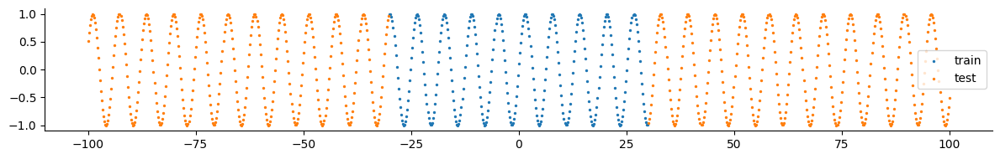

In [8]:
x_train, y_train, x_test, y_test = gen_data(L=1000, prop_train=0.3, start=-100, end=100, reverse=False)

fig, axs = plt.subplots(1, 1, figsize=(12, 2))
plt.scatter(x_train, y_train, label='train', s=2)
plt.scatter(x_test, y_test, label='test', s=2)
plt.legend()
plt.tight_layout()
axs.spines[['right', 'top']].set_visible(False)

We show an animation below of the neural network parameters and the evolution of how it fits the data over its training (epochs).

In these experiments, we used
* Xavier Normal initialization
* Two hidden layers
* 256 neurons per hidden layer
* learning rate = 0.0001
* a = 15 for the activation functions

We experimented on different model complexities and see how they fit the data and generalize over the test set.

We find that as the number of nodes per layer increases, while maintaing a fixed N-layers, the ability of the model improves.

In [9]:
count_nodes = 256
lr = 0.0001
batch_size = len(x_train) - 1

frames = 50
epochs_per_frame = 400

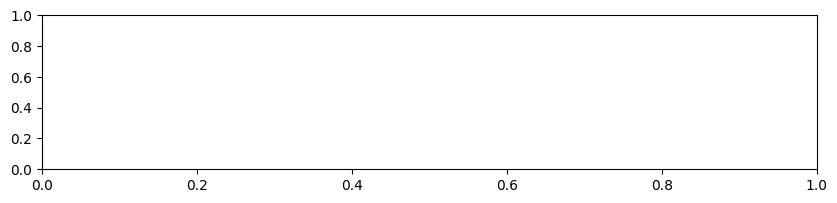

In [10]:
# for animation
fig, axs = plt.subplots(1, 1, figsize=(10, 2)) # dpi=200)

### $sin(ax)$

In [11]:
norm = False
resnet=False
emb_loss_beta = 0
activation="sine"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

### $sin^2(ax)$

In [12]:
norm = False
resnet=False
emb_loss_beta = 0
activation="sin^2(ax)"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

### $x + \frac{1}{a}sin(ax)$

In [13]:
norm = False
resnet=False
emb_loss_beta = 0
activation="x + sin(ax)/a"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

### $x + sin^2(ax)$

In [14]:
norm = False
resnet=False
emb_loss_beta = 0
activation="x+sin^2(ax)"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

### $x + \frac{1}{a}sin^2(x)$

In [15]:
norm = False
resnet=False
emb_loss_beta = 0
activation="x+sin^2(x)/a"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

### $x + \frac{1}{a}sin^2(ax)$ (Snake)

In [16]:
norm = False
resnet=False
emb_loss_beta = 0
activation="snake"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

## Interpolation Experiment

Now what if we make this an interpolation problem instead of an extrapolation problem. In other words, what if we reverse the train and test set? Will the model be able to infer the sine wave in between the test data? We show below the sine wave colored by train (blue) and test (orange)

Note that we use the term "interpolate" loosely here. This is technically still an extrapolation problem since the distribution of the test set is not within the support of the distribution of the training set.

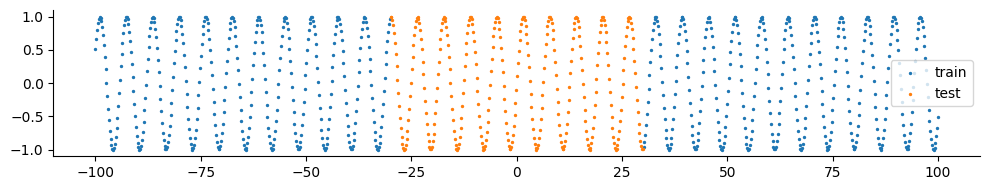

In [17]:
x_train, y_train, x_test, y_test = gen_data(L=1000, prop_train=0.3, start=-100, end=100, reverse=True)

fig, axs = plt.subplots(1, 1, figsize=(10, 2))
plt.scatter(x_train, y_train, label='train', s=2)
plt.scatter(x_test, y_test, label='test', s=2)
plt.legend()
plt.tight_layout()
axs.spines[['right', 'top']].set_visible(False)

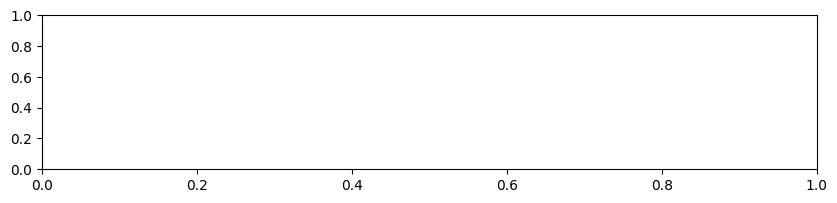

In [18]:
# for animation
fig, axs = plt.subplots(1, 1, figsize=(10, 2)) # dpi=200)

### $sin(ax)$

In [19]:
norm = False
resnet=False
emb_loss_beta = 0
activation="sine"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

### $sin^2(ax)$

In [20]:
norm = False
resnet=False
emb_loss_beta = 0
activation="sin^2(ax)"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

### $x + sin(ax)/a$

In [24]:
norm = False
resnet=False
emb_loss_beta = 0
activation="x + sin(ax)/a"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

### $x + sin^2(ax)$

In [22]:
norm = False
resnet=False
emb_loss_beta = 0
activation="x + sin^2(ax)"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

### $x + \frac{1}{a}sin^2(x)$

In [23]:
norm = False
resnet=False
emb_loss_beta = 0
activation="x + sin^2(x)/a"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

### $x + \frac{1}{a}sin^2(ax)$ (Snake)

In [25]:
norm = False
resnet=False
emb_loss_beta = 0
activation="snake"
snake_a = 15

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

## How does $a$ of Snake activation affect the model predictions?

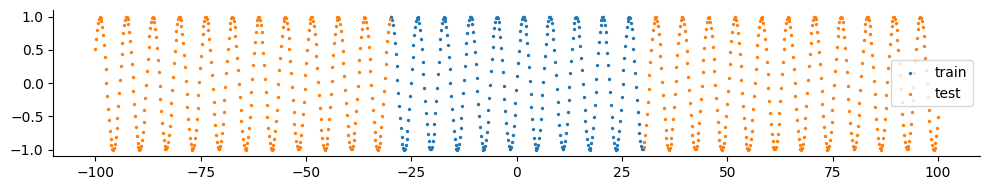

In [26]:
x_train, y_train, x_test, y_test = gen_data(L=1000, prop_train=0.3, start=-100, end=100, reverse=False)

fig, axs = plt.subplots(1, 1, figsize=(10, 2))
plt.scatter(x_train, y_train, label='train', s=2)
plt.scatter(x_test, y_test, label='test', s=2)
plt.legend()
plt.tight_layout()
axs.spines[['right', 'top']].set_visible(False)

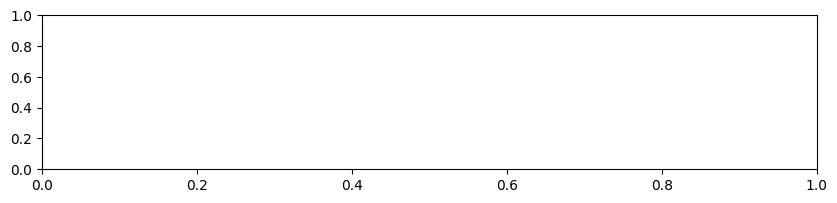

In [27]:
# for animation
fig, axs = plt.subplots(1, 1, figsize=(10, 2)) # dpi=200)

In [28]:
norm = False
resnet=False
emb_loss_beta = 0
activation="snake"
snake_a = 1

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

In [29]:
norm = False
resnet=False
emb_loss_beta = 0
activation="snake"
snake_a = 5

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

In [30]:
norm = False
resnet=False
emb_loss_beta = 0
activation="snake"
snake_a = 20

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

In [31]:
norm = False
resnet=False
emb_loss_beta = 0
activation="snake"
snake_a = 100

model = MLP(count_nodes, resnet, norm, activation=activation, snake_a=snake_a)
model = model.to(device)
optim = torch.optim.Adam(model.parameters(),lr=lr)
# scheduler = torch.optim.lr_scheduler.StepLR(optim, step_size= 1000)

anim = animation.FuncAnimation(fig,
                               animate,
                               frames=frames,
                               interval=1)
HTML(anim.to_jshtml(fps=10))

## Take-aways

We performed an ablation study on how the activation function learns to extrapolate a sine function from a short segment of data.

It looks like Snake activation does perform best compared to alternative, but similar-looking activation functions. The activation with the closest performance to Snake is $x + \frac{1}{a}sin(ax)$ that doesn't square the sine.

Snake has more trouble "interpolating" (loose definition) a missing segment in a sine function compared to Snake activation. This could be a limitation of Snake. How is it that it can extrapolate outward but not "interpolate" (or more precisely, extrapolate between training data)

Interestingly, the model that used $x + sin^2(ax)$ and $x + \frac{1}{a}sin^2(x)$ "collapsed" to just predicting a near-horizontal line.

This tells us that the precise formulation of Snake is important and deviations from this formula can lead to collapse or worse extrapolation.

We also found the importance of selecting the $a$ parameter for the Snake activation. If it is too small, then the model does not learn to extrapolate well. It seems for this task, Snake is not sensitive to very high values of $a$